In [1]:
import geopandas as gpd
import numpy as np
norway = gpd.read_file(r"C:/Users/Raul/Desktop/TFM/Norway_shapefile/gadm41_NOR_0.shp").to_crs("EPSG:4326")  # or the CRS of your climate maps


In [2]:
import xarray as xr
import rioxarray

def clip_to_norway(nc_path, norway_gdf):
    ds = xr.open_dataset(nc_path)
    var_name = list(ds.data_vars.keys())[-1]
    
    # Convert to DataArray and set spatial dims for rioxarray
    da = ds[var_name]
    da.rio.set_spatial_dims(x_dim="lon", y_dim="lat", inplace=True)
    da.rio.write_crs("EPSG:4326", inplace=True)

    # Clip to Norway
    clipped = da.rio.clip(norway_gdf.geometry.values, norway_gdf.crs, drop=True)
    
    return clipped


In [3]:
path_altitude = r"C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc"
variables =['gdd5', 'prsd', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd'] 
# file_paths = [f"CHELSA\\1991-2020\\chelsav2\\EUR11\\obs\\annual\\V2.1\\{var}\\CHELSA_EUR11_obs_{var}_{sample.year}_V.2.1.nc" for var in variables]
# file_paths.append(path_altitude)
years = list(range(1991, 2019))
# years
years

[1991,
 1992,
 1993,
 1994,
 1995,
 1996,
 1997,
 1998,
 1999,
 2000,
 2001,
 2002,
 2003,
 2004,
 2005,
 2006,
 2007,
 2008,
 2009,
 2010,
 2011,
 2012,
 2013,
 2014,
 2015,
 2016,
 2017,
 2018]

In [4]:
import xarray as xr

# Initialize a dictionary to store climate cubes for each year
climate_cubes_by_year = {}

for year in years:
    # Create file paths for CHELSA variables + altitude
    file_paths = {var: f"C:\\Users\\Raul\\Desktop\\TFM\\CHELSA\\1991-2020\\chelsav2\\EUR11\\obs\\annual\\V2.1\\{var}\\CHELSA_EUR11_obs_{var}_{year}_V.2.1.nc" for var in variables}
    file_paths["altitude"] = path_altitude  # Add altitude

    # Clip and align all variables
    clipped_layers = {var: clip_to_norway(fp, norway) for var, fp in file_paths.items()}
    aligned_layers = xr.align(*clipped_layers.values(), join="override")

    # Create a dictionary of aligned DataArrays
    dataset_dict = {
        var: layer for var, layer in zip(clipped_layers.keys(), aligned_layers)
    }

    # Combine into a Dataset
    norway_climate_dataset = xr.Dataset(dataset_dict)

    # Save to NetCDF
    output_path = f"C:\\Users\\Raul\\Desktop\\TFM\\CHELSA\\climate_cubes\\climate_cube_{year}.nc"
    norway_climate_dataset.to_netcdf(output_path)

    # Store in memory if needed
    climate_cubes_by_year[year] = norway_climate_dataset
    print(f"Saved climate cube for {year}")


Saved climate cube for 1991
Saved climate cube for 1992
Saved climate cube for 1993
Saved climate cube for 1994
Saved climate cube for 1995
Saved climate cube for 1996
Saved climate cube for 1997
Saved climate cube for 1998
Saved climate cube for 1999
Saved climate cube for 2000
Saved climate cube for 2001
Saved climate cube for 2002
Saved climate cube for 2003
Saved climate cube for 2004
Saved climate cube for 2005
Saved climate cube for 2006
Saved climate cube for 2007
Saved climate cube for 2008
Saved climate cube for 2009
Saved climate cube for 2010
Saved climate cube for 2011
Saved climate cube for 2012
Saved climate cube for 2013
Saved climate cube for 2014
Saved climate cube for 2015
Saved climate cube for 2016
Saved climate cube for 2017
Saved climate cube for 2018


### Loading climatic maps

Variables in dataset: ['gdd5', 'prsd', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd', 'altitude']


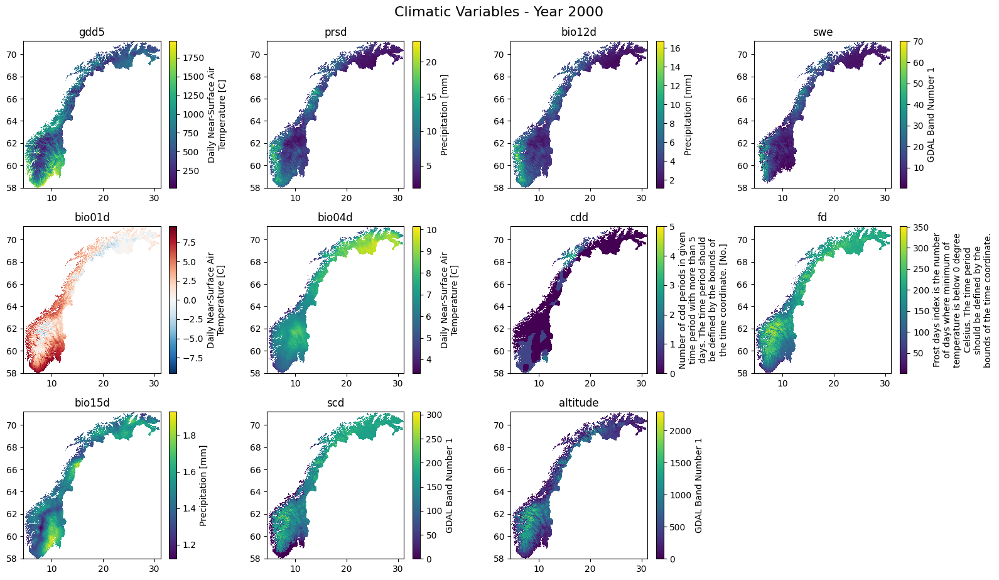

Variables in dataset: ['gdd5', 'prsd', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd', 'altitude']


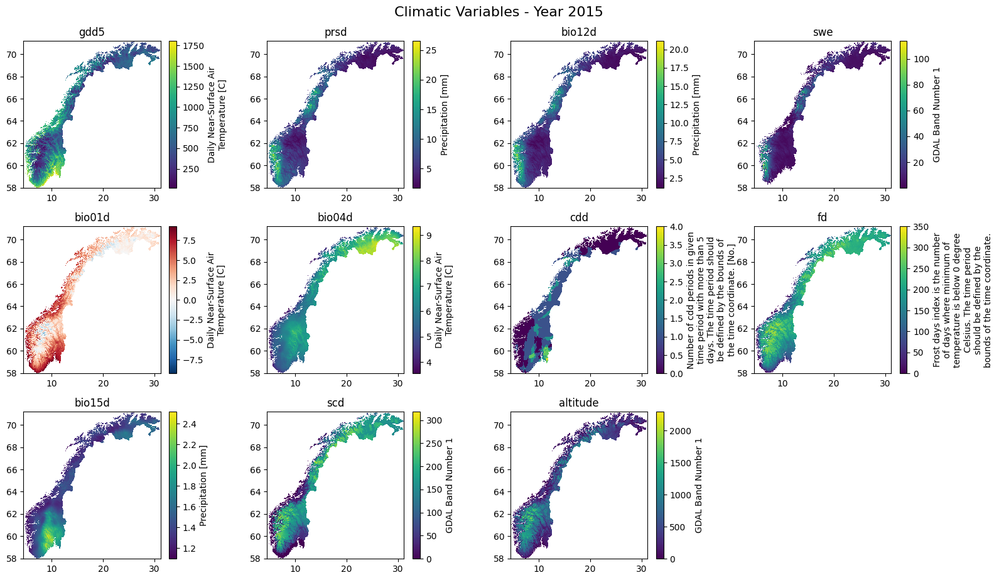

In [4]:
import xarray as xr
import matplotlib.pyplot as plt
year = '2015'

def climatic_map_loading(year):
    # Load the dataset
    file_path = f"C:\\Users\\Raul\\Desktop\\TFM\\CHELSA\\climate_cubes\\climate_cube_{year}.nc"
    ds = xr.open_dataset(file_path)
    
    # List all variable names
    variables = list(ds.data_vars)[1:]
    print("Variables in dataset:", variables)
    
    # Set up subplot grid (e.g., 3 rows x 4 cols for 11 vars)
    n_vars = len(variables)
    n_cols = 4
    n_rows = (n_vars + n_cols - 1) // n_cols  # ceiling division
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, 3 * n_rows))
    axes = axes.flatten()
    
    # Plot each variable
    for i, var in enumerate(variables):
        data = ds[var]
        
        # If time dimension exists, take the first time step
        if "time" in data.dims:
            data = data.isel(time=0)
            
        data.plot(ax=axes[i], add_colorbar=True)
        axes[i].set_title(var)
        axes[i].set_xlabel("")
        axes[i].set_ylabel("")
    
    # Turn off any unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis("off")
    
    plt.tight_layout()
    plt.suptitle(f"Climatic Variables - Year {year}", fontsize=16, y=1.02)
    plt.show()
climatic_map_loading('2000')
climatic_map_loading('2015')

### Extracting absolute max/min values

In [5]:
import xarray as xr
import pandas as pd

# Folder where all NetCDF files are stored
folder = "C:\\Users\\Raul\\Desktop\\TFM\\CHELSA\\climate_cubes\\"

# Years you want to include (1991 to 2018)
years = list(range(1991, 2019))  # 1991 to 2018

# Initialize a dictionary to store results
summary_stats = {"Variable": [], "Min": [], "Max": []}

# Loop through all years and calculate min/max for each variable
for year in years:
    file_path = f"{folder}climate_cube_{year}.nc"
    
    # Open the NetCDF file for the current year
    ds = xr.open_dataset(file_path)
    
    # Loop through all variables in the dataset
    for var in ds.data_vars:
        data = ds[var]
        
        # Calculate the min and max across the entire time for each variable
        min_val = float(data.min().values)
        max_val = float(data.max().values)
        
        # Store the results in the dictionary
        summary_stats["Variable"].append(f"{var}_{year}")
        summary_stats["Min"].append(min_val)
        summary_stats["Max"].append(max_val)

# Convert the dictionary to a Pandas DataFrame for better readability
df_stats = pd.DataFrame(summary_stats)

# Print the results
print(df_stats)


          Variable        Min          Max
0         crs_1991   0.000000     0.000000
1        gdd5_1991  22.800165  1755.852539
2        prsd_1991   1.706011    26.772648
3      bio12d_1991   0.910274    17.635918
4         swe_1991   0.602994    89.603088
..             ...        ...          ...
331       cdd_2018   0.000000     7.000000
332        fd_2018   8.000000   324.000000
333    bio15d_2018   1.191187     2.776269
334       scd_2018   0.000000   298.000000
335  altitude_2018   0.000000  2296.000000

[336 rows x 3 columns]


In [6]:
import pandas as pd

# Sample of df_stats that contains min and max values for each year
# You already have this DataFrame, just proceed with the next steps

# Remove the year suffix (e.g., '_1991', '_2018') from the Variable column
df_stats['Variable'] = df_stats['Variable'].str.replace(r'_\d{4}', '', regex=True)

# Now we can group by the variable name and extract the absolute min/max across all years
absolute_stats = df_stats.groupby('Variable').agg({'Min': 'min', 'Max': 'max'}).reset_index()

# Print the results
absolute_stats


,Variable,Min,Max
0,altitude,0.000000,2296.000000
1,bio01d,-9.149994,10.450012
2,bio04d,3.150024,157.550018
3,bio12d,0.910274,21.650711
4,bio15d,1.052361,2.776269
5,cdd,0.000000,8.000000
6,crs,0.000000,0.000000
7,fd,0.000000,362.000000
8,gdd5,1.900041,3858.301514
9,prsd,1.446217,29.098524


In [7]:
# absolute_stats.to_csv(r'C:\Users\Raul\Desktop\TFM\Data\absolute_stats.csv',index = False)


### Creating Patches

In [8]:
file_name = r'C:\Users\Raul\Desktop\TFM\Data\assemblages_aggregated_by_grid_with_centroids.csv'
gbif_assemblages_1991_2020 = pd.read_csv(file_name)

# Filter the gbif_assemblages DataFrame for years <= 2018
gbif_assemblages = gbif_assemblages_1991_2020[gbif_assemblages_1991_2020['year'] <= 2018]

gbif_assemblages

,grid_index,year,species,longitude,latitude
1,79231,2011,"['Angelica archangelica', 'Dactylorhiza majali...",5.172939,59.201189
2,79231,2012,"['Carex distans', 'Euphrasia foulaensis', 'Car...",5.172939,59.201189
3,79231,2014,"['Lysimachia europaea', 'Ficaria verna', 'Junc...",5.172939,59.201189
4,79231,2015,"['Tripolium pannonicum', 'Centaurium littorale...",5.172939,59.201189
5,79231,2016,"['Lysimachia europaea', 'Lythrum salicaria', '...",5.172939,59.201189
...,...,...,...,...,...
71740,1818627,2012,"['Avenella flexuosa', 'Lathyrus japonicus', 'H...",30.835603,69.774990
71741,1818627,2017,"['Luzula spicata', 'Antennaria dioica', 'Cochl...",30.835603,69.774990
71742,1820117,1994,"['Honckenya peploides', 'Alnus incana', 'Epilo...",30.847255,69.755439
71743,1821608,1994,"['Taraxacum spectabile', 'Astragalus norvegicu...",30.865522,69.744514


In [9]:
year = '2011'
file_path = f"C:\\Users\\Raul\\Desktop\\TFM\\CHELSA\\climate_cubes\\climate_cube_{year}.nc"
ds = xr.open_dataset(file_path)

# Get variable list and process each one
variables = list(ds.data_vars)[1:]  # Skip first if needed
print(variables)
stacked = []
print(ds)

['gdd5', 'prsd', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd', 'altitude']
<xarray.Dataset> Size: 223MB
Dimensions:      (time: 1, lon: 3198, lat: 1587)
Coordinates:
  * time         (time) datetime64[ns] 8B 2011-07-02
  * lon          (lon) float64 26kB 4.512 4.521 4.529 ... 31.14 31.15 31.15
  * lat          (lat) float64 13kB 57.96 57.97 57.98 ... 71.16 71.17 71.18
    spatial_ref  int32 4B ...
Data variables:
    crs          int32 4B ...
    gdd5         (time, lat, lon) float32 20MB ...
    prsd         (time, lat, lon) float32 20MB ...
    bio12d       (time, lat, lon) float32 20MB ...
    swe          (lat, lon) float32 20MB ...
    bio01d       (time, lat, lon) float32 20MB ...
    bio04d       (time, lat, lon) float32 20MB ...
    cdd          (time, lat, lon) float32 20MB ...
    fd           (time, lat, lon) float32 20MB ...
    bio15d       (time, lat, lon) float32 20MB ...
    scd          (lat, lon) float32 20MB ...
    altitude     (lat, lon) float3

In [10]:
# Load the NetCDF file
def read_netcdf(file_path,latitude,longitude,grid,location):
    data = xr.open_dataset(file_path)
    # data = xr.open_dataset(file_path)
    # Step 1: Find the indices of the closest grid point
    lat_idx = np.argmin(np.abs(data['lat'].values - latitude))
    lon_idx = np.argmin(np.abs(data['lon'].values - longitude))
    
    # Step 2: Select all months of the year
    #precipitation= data.sel(**{"time": slice(1, 12)})

    # Extract variable name (it is always the last variable)
    variable = list(data.data_vars.keys())[-1]
    print(variable)
    # Step 3: Extract a 10x10 grid centered around Bergen
    patch = data[variable].isel(
        lat=slice(lat_idx - grid, lat_idx + grid),
        lon=slice(lon_idx - grid, lon_idx + grid)
    )
    
    # Step 4: Calculate the mean precipitation across all months
    #mean_patch = patch.mean(dim="time")
    
    # Step 5: Plot with Cartopy for map context
    plt.figure(figsize=(10, 8))
    ax = plt.axes(projection=ccrs.PlateCarree())  # PlateCarree assumes latitude/longitude
    
    # Plot the precipitation data
    # mean_patch.plot(ax=ax, cmap="Blues", transform=ccrs.PlateCarree(), add_colorbar=True)
    patch.plot(ax=ax, cmap="Blues", transform=ccrs.PlateCarree(), add_colorbar=True)
    
    # Add map features
    ax.add_feature(cfeature.BORDERS, linestyle=':', edgecolor='black')  # Country borders
    ax.add_feature(cfeature.COASTLINE, edgecolor='black')               # Coastline
    # ax.set_extent([mean_patch.lon.min(), mean_patch.lon.max(), mean_patch.lat.min(), mean_patch.lat.max()])
    ax.set_extent([patch.lon.min(), patch.lon.max(), patch.lat.min(), patch.lat.max()])

    
    # Add city marker for Bergen
    plt.scatter(longitude, latitude, color="red", label=location, transform=ccrs.PlateCarree())
    plt.legend()
    
    # Title and labels
    plt.title(f"{variable} in {location}, (10x10 grid)")
    plt.show()

    return patch

frost_days_index_per_time_period


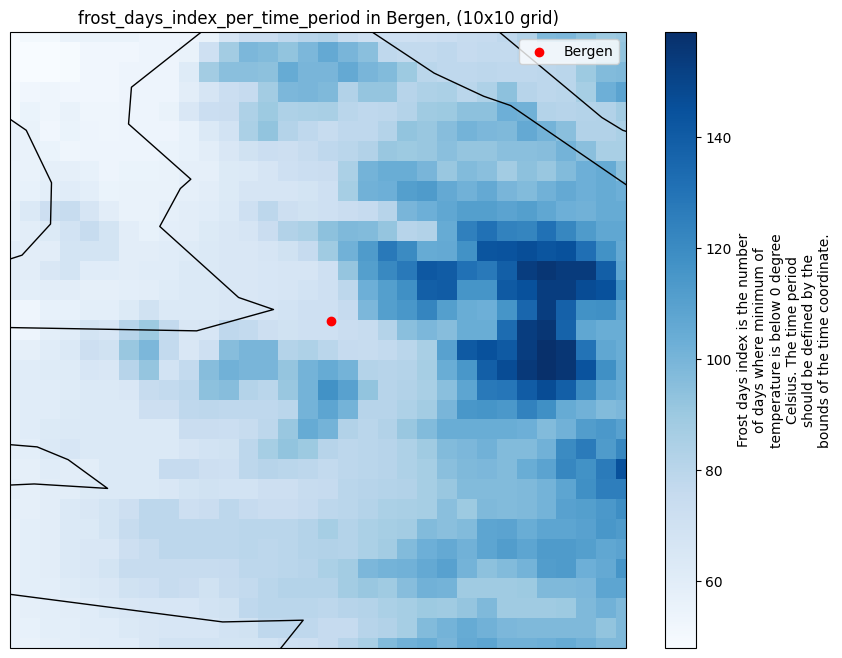

pr


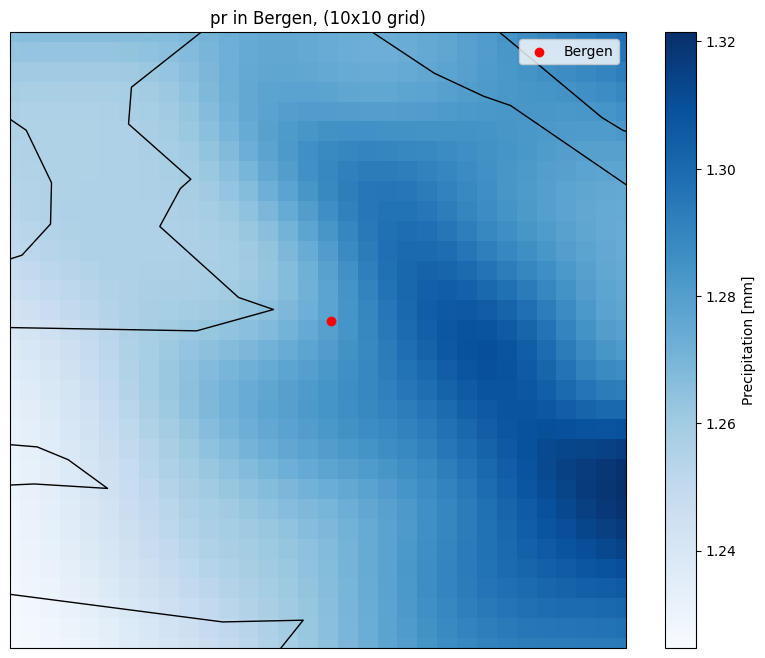

In [12]:
import cartopy.feature as cfeature  # Import the cfeature module
import cartopy.crs as ccrs

path_fd = r"C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/fd/CHELSA_EUR11_obs_fd_2011_V.2.1.nc"
path_bio15d = r"C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio15d/CHELSA_EUR11_obs_bio15d_2000_V.2.1.nc"

fd = read_netcdf(file_path = path_fd, #path_prsd,
            latitude = 60.3913,
            longitude = 5.3221,
            # variable = 'pr',
            grid = 16,
            location = 'Bergen')
bio15d = read_netcdf(file_path = path_bio15d,#path_prsd,
            latitude = 60.3913,
            longitude = 5.3221,
            # variable = 'pr',
            grid = 16,
            location = 'Bergen')

As we can see there are many NA values so we might stick to the original preprocessing pipeline

In [15]:
def read_netcdf_stack(file_paths, latitude, longitude, grid):
    patches = []
    # scaler = MinMaxScaler(feature_range=(0, 1))  # Define the scaler

    for file_path in file_paths:
        data = xr.open_dataset(file_path)
        variable = list(data.data_vars.keys())[-1]

        lat_idx = np.argmin(np.abs(data['lat'].values - latitude))
        lon_idx = np.argmin(np.abs(data['lon'].values - longitude))

        patch = data[variable].isel(
            lat=slice(lat_idx - grid, lat_idx + grid),
            lon=slice(lon_idx - grid, lon_idx + grid)
        ).fillna(0).values  # Convert to NumPy

        print(f"Shape of patch for {file_path} {variable}: {patch.shape}")

        # Remove extra dimension if necessary
        if patch.shape[0] == 1:
            patch = patch[0]

        # # Reshape for MinMax scaling (flatten to 2D)
        # patch_reshaped = patch.reshape(-1, 1)  # Flatten but keep 1 feature

        # # Apply MinMax Scaling
        # patch_scaled = scaler.fit_transform(patch_reshaped)

        # # Reshape back to original (grid*2, grid*2)
        # patch_scaled = patch_scaled.reshape(patch.shape)

        # patches.append(patch_scaled)  # Add scaled patch
        
        patches.append(patch)  # Add NOT scaled patch


    # Stack along last axis (channels dimension)
    stacked_patches = np.stack(patches, axis=-1)

    return stacked_patches

In [16]:

# Example Usage:
# Define the file paths for each variable (you need to have the full paths for each variable)
path_altitude = r"C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc"

variables = ['gdd5', 'prsd', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd']
file_paths = [f"C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/{var}/CHELSA_EUR11_obs_{var}_2000_V.2.1.nc" for var in variables]
file_paths.append(path_altitude)
latitude = 62.9,
longitude = 8.2,
grid_size = 16 # 10x10 grid bc we substract 5 from lat and 5 from lon

# Call the function to get the stacked patches
stacked_patches = read_netcdf_stack(file_paths, latitude, longitude, grid_size)

# Now stacked_patches is a 3D numpy array with shape (10, 10, 10), representing a 10x10 grid with 10 channels

Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/gdd5/CHELSA_EUR11_obs_gdd5_2000_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/prsd/CHELSA_EUR11_obs_prsd_2000_V.2.1.nc pr: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio12d/CHELSA_EUR11_obs_bio12d_2000_V.2.1.nc pr: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/swe/CHELSA_EUR11_obs_swe_2000_V.2.1.nc Band1: (32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio01d/CHELSA_EUR11_obs_bio01d_2000_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio04d/CHELSA_EUR11_obs_bio04d_2000_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual

In [ ]:
# Define the file paths for each variable (you need to have the full paths for each variable)
path_altitude = r"C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc"

variables =['gdd5', 'prsd', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd'] # 'swe', we have removed it bc it has Nan values in many cases

stacked_patches_list = []
# x = 100
for i in range(gbif_assemblages.shape[0]): # gbif_assemblages.shape[0]
    sample =  gbif_assemblages.iloc[i]
    file_paths = [f"C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/{var}/CHELSA_EUR11_obs_{var}_{sample.year}_V.2.1.nc" for var in variables]
    file_paths.append(path_altitude)
    
    # Call the function to get the stacked patches
    stacked_patches = read_netcdf_stack(file_paths = file_paths, 
                                        latitude = sample.latitude, 
                                        longitude = sample.longitude, 
                                        grid = 16) # better to use multiples of 64
    
    stacked_patches_list.append(stacked_patches)

    print(f'Sample {i} correctly stacked and added to the list')
    print('\n\n')

Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/gdd5/CHELSA_EUR11_obs_gdd5_2011_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/prsd/CHELSA_EUR11_obs_prsd_2011_V.2.1.nc pr: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio12d/CHELSA_EUR11_obs_bio12d_2011_V.2.1.nc pr: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/swe/CHELSA_EUR11_obs_swe_2011_V.2.1.nc Band1: (32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio01d/CHELSA_EUR11_obs_bio01d_2011_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio04d/CHELSA_EUR11_obs_bio04d_2011_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual

In [27]:
gbif_assemblages_climatic = gbif_assemblages#.head(x)

gbif_assemblages_climatic['climatic_map'] = stacked_patches_list

C:\Users\Raul\AppData\Local\Temp\ipykernel_22432\1734215039.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gbif_assemblages_climatic['climatic_map'] = stacked_patches_list


In [28]:
gbif_assemblages_climatic

,grid_index,year,species,longitude,latitude,climatic_map,species_vector
1,79231,2011,"[Angelica archangelica, Dactylorhiza majalis, ...",5.172939,59.201189,"[[[1607.7528, 5.027073, 3.9653697, 0.0, 8.8500...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
2,79231,2012,"[Carex distans, Euphrasia foulaensis, Carex ot...",5.172939,59.201189,"[[[1397.5029, 5.1999106, 4.095109, 0.0, 8.3500...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
3,79231,2014,"[Lysimachia europaea, Ficaria verna, Juncus ar...",5.172939,59.201189,"[[[1831.9033, 5.531074, 3.7544656, 0.0, 9.75, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
4,79231,2015,"[Tripolium pannonicum, Centaurium littorale, P...",5.172939,59.201189,"[[[1593.9033, 4.5897136, 3.8675342, 0.0, 9.25,...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
5,79231,2016,"[Lysimachia europaea, Lythrum salicaria, Vacci...",5.172939,59.201189,"[[[1700.103, 4.5414343, 3.0318031, 0.0, 9.25, ...","[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
...,...,...,...,...,...,...,...
71740,1818627,2012,"[Avenella flexuosa, Lathyrus japonicus, Honcke...",30.835603,69.774990,"[[[467.9513, 4.514784, 2.370765, 4.342335, 0.2...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
71741,1818627,2017,"[Luzula spicata, Antennaria dioica, Cochlearia...",30.835603,69.774990,"[[[512.6012, 3.7625601, 2.388959, 6.5053787, 0...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
71742,1820117,1994,"[Honckenya peploides, Alnus incana, Epilobium ...",30.847255,69.755439,"[[[495.45108, 3.9898138, 2.4103835, 8.624214, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
71743,1821608,1994,"[Taraxacum spectabile, Astragalus norvegicus, ...",30.865522,69.744514,"[[[498.8011, 3.9873393, 2.3976712, 8.537665, 0...","[0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, ..."


In [31]:
import ast

# Ensure all rows are properly parsed as lists
# gbif_assemblages_climatic['species'] = gbif_assemblages_climatic['species'].apply(ast.literal_eval)

gbif_assemblages_climatic['species']

1        [Angelica archangelica, Dactylorhiza majalis, ...
2        [Carex distans, Euphrasia foulaensis, Carex ot...
3        [Lysimachia europaea, Ficaria verna, Juncus ar...
4        [Tripolium pannonicum, Centaurium littorale, P...
5        [Lysimachia europaea, Lythrum salicaria, Vacci...
                               ...                        
71740    [Avenella flexuosa, Lathyrus japonicus, Honcke...
71741    [Luzula spicata, Antennaria dioica, Cochlearia...
71742    [Honckenya peploides, Alnus incana, Epilobium ...
71743    [Taraxacum spectabile, Astragalus norvegicus, ...
71745    [Juncus bufonius, Epilobium palustre, Alchemil...
Name: species, Length: 59074, dtype: object

In [32]:
from itertools import chain

# Flatten the lists and remove duplicates
species_list = list(set(chain.from_iterable(gbif_assemblages_climatic['species'])))
len(species_list),species_list

(5357,
 ['Rosa omeiensis',
  'Polygonatum odoratum',
  'Empetrum nigrum',
  'Iris delavayi',
  'Lathyrus tuberosus',
  'Iris confusa',
  'Amelanchier arborea',
  'Murraya paniculata',
  'Lepidium oblongum',
  'Scirpus caespitosus',
  'Aciphylla horrida',
  'Bunias orientalis',
  'Phyllodoce caerulea',
  'Equisetum variegatum',
  'Alchemilla propinqua',
  'Poa remota',
  'Bergenia ciliata',
  'Calla palustris',
  'Psephellus leucophyllus',
  'Adenophora triphylla',
  'Sisymbrium orientale',
  'Lavandula buchii',
  'Elymus macrourus',
  'Sedum sexangulare',
  'Leonotis leonurus',
  'Crocus tommasinianus',
  'Monarda media',
  'Polygonatum curvistylum',
  'Eucalyptus parvifolia',
  'Cycnogeton procerum',
  'Cerastium holosteoides',
  'Dysosma difformis',
  'Arnica angustifolia',
  'Sium suave',
  'Helleborus foetidus',
  'Rodgersia aesculifolia',
  'Cuscuta campestris',
  'Sempervivum globiferum',
  'Colchicum autumnale',
  'Smilax glauca',
  'Buglossoides arvensis',
  'Drosera longifolia

In [33]:
import json
with open(r"C:\Users\Raul\GitHub\Species_Distribution_Modeling\data\species_universe_filtered_10.json", "r") as file:
    species_universe = json.load(file)

In [34]:
import json
vector_length = len(species_universe)
# Create binary vectors for each row
def species_to_vector(species_list):
    vector = np.zeros(vector_length, dtype=int)  # Initialize zeros
    for species in species_list:
        if species in species_universe:  # Check if species is in the dictionary
            vector[species_universe[species]] = 1  # Set corresponding position to 1
    return vector

# Apply the function to create binary vectors
gbif_assemblages_climatic.loc[:, 'species_vector'] = gbif_assemblages_climatic['species'].apply(species_to_vector)

# Display the DataFrame
gbif_assemblages_climatic

,grid_index,year,species,longitude,latitude,climatic_map,species_vector
1,79231,2011,"[Angelica archangelica, Dactylorhiza majalis, ...",5.172939,59.201189,"[[[1607.7528, 5.027073, 3.9653697, 0.0, 8.8500...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
2,79231,2012,"[Carex distans, Euphrasia foulaensis, Carex ot...",5.172939,59.201189,"[[[1397.5029, 5.1999106, 4.095109, 0.0, 8.3500...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
3,79231,2014,"[Lysimachia europaea, Ficaria verna, Juncus ar...",5.172939,59.201189,"[[[1831.9033, 5.531074, 3.7544656, 0.0, 9.75, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
4,79231,2015,"[Tripolium pannonicum, Centaurium littorale, P...",5.172939,59.201189,"[[[1593.9033, 4.5897136, 3.8675342, 0.0, 9.25,...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
5,79231,2016,"[Lysimachia europaea, Lythrum salicaria, Vacci...",5.172939,59.201189,"[[[1700.103, 4.5414343, 3.0318031, 0.0, 9.25, ...","[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
...,...,...,...,...,...,...,...
71740,1818627,2012,"[Avenella flexuosa, Lathyrus japonicus, Honcke...",30.835603,69.774990,"[[[467.9513, 4.514784, 2.370765, 4.342335, 0.2...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
71741,1818627,2017,"[Luzula spicata, Antennaria dioica, Cochlearia...",30.835603,69.774990,"[[[512.6012, 3.7625601, 2.388959, 6.5053787, 0...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
71742,1820117,1994,"[Honckenya peploides, Alnus incana, Epilobium ...",30.847255,69.755439,"[[[495.45108, 3.9898138, 2.4103835, 8.624214, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
71743,1821608,1994,"[Taraxacum spectabile, Astragalus norvegicus, ...",30.865522,69.744514,"[[[498.8011, 3.9873393, 2.3976712, 8.537665, 0...","[0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, ..."


In [35]:
len(gbif_assemblages_climatic['species_vector'].iloc[0]),gbif_assemblages_climatic['species_vector'].iloc[0]

(1819, array([0, 0, 0, ..., 0, 0, 0]))

In [36]:
gbif_assemblages_climatic['species_vector'].iloc[4],gbif_assemblages_climatic['species'].iloc[4]

(array([0, 0, 1, ..., 0, 0, 0]),
 ['Lysimachia europaea',
  'Lythrum salicaria',
  'Vaccinium oxycoccos',
  'Centaurium littorale',
  'Pedicularis sylvatica',
  'Viola palustris',
  'Eriophorum vaginatum',
  'Convallaria majalis',
  'Primula vulgaris',
  'Cornus suecica',
  'Armeria maritima',
  'Empetrum nigrum',
  'Parnassia palustris',
  'Rhodiola rosea',
  'Potentilla erecta',
  'Triglochin maritima',
  'Silene dioica'])

In [39]:
import pickle
# Save DataFrame as a Pickle file
with open(r'../data/Full_Scale/NO_NORM_10_filtered_vectorized_gbif_assemblages_climatic_1991-2018_32.pkl', "wb") as file_2:
    pickle.dump(gbif_assemblages_climatic, file_2)

### Visualizing The Climatic Maps

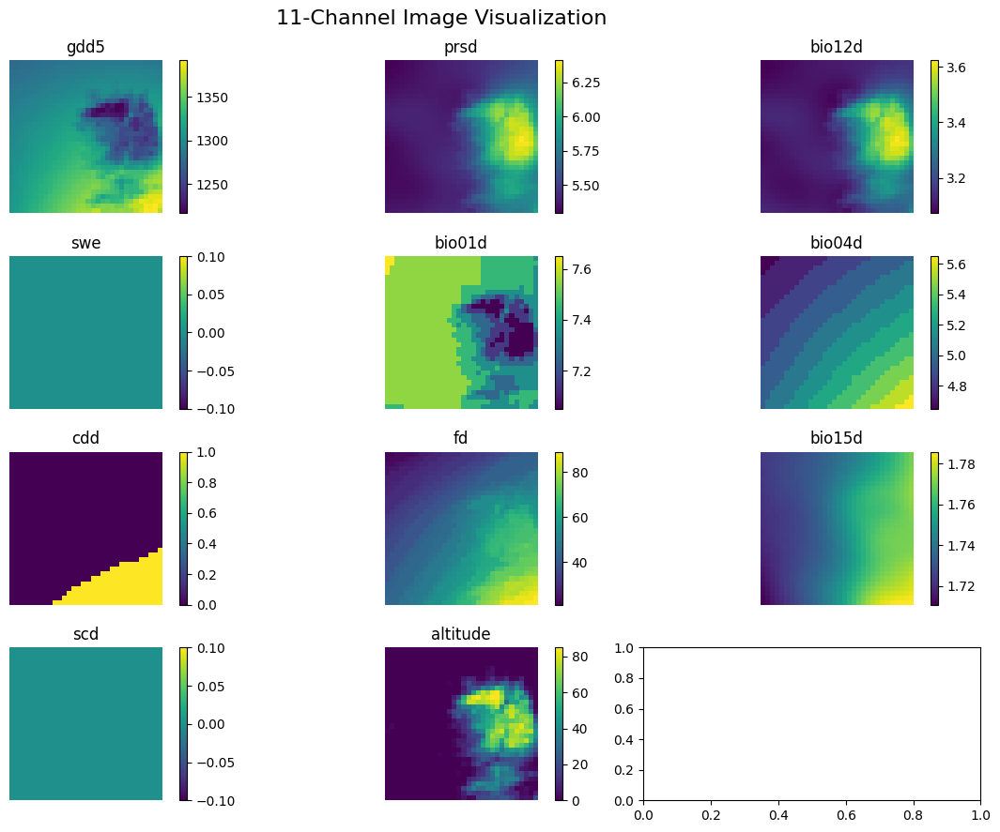

In [40]:
import numpy as np
import matplotlib.pyplot as plt

# Example 10-channel image (Replace with your actual data)
image_10ch = gbif_assemblages_climatic.iloc[44].climatic_map  # Shape (Height, Width, 10)

# Set up a 3-row, 3-column grid for 9 channels
fig, axes = plt.subplots(4,3, figsize=(12, 9))  # Adjust layout for 9 images
fig.suptitle("11-Channel Image Visualization", fontsize=16)

# Create a color map
cmap = plt.get_cmap("viridis")
variable_names = variables
variable_names.append('altitude')
for i in range(11):  # Loop over the first 9 channels
    ax = axes[i // 3, i % 3]  # Position in grid
    img = ax.imshow(image_10ch[:, :, i], cmap=cmap)  # Use a colormap for visualization
    ax.set_title(f"{variables[i]}")
    ax.axis("off")  # Hide axes

    # Add colorbar for each subplot
    fig.colorbar(img, ax=ax, orientation='vertical')
plt.tight_layout()
plt.show()


#### Testing

In [26]:
import numpy as np
# Loop through the dictionary and replace NaN by 0 in each cube
for year, cube in climate_cubes_by_year.items():
    climate_cubes_by_year[year] = np.nan_to_num(cube, nan=0)

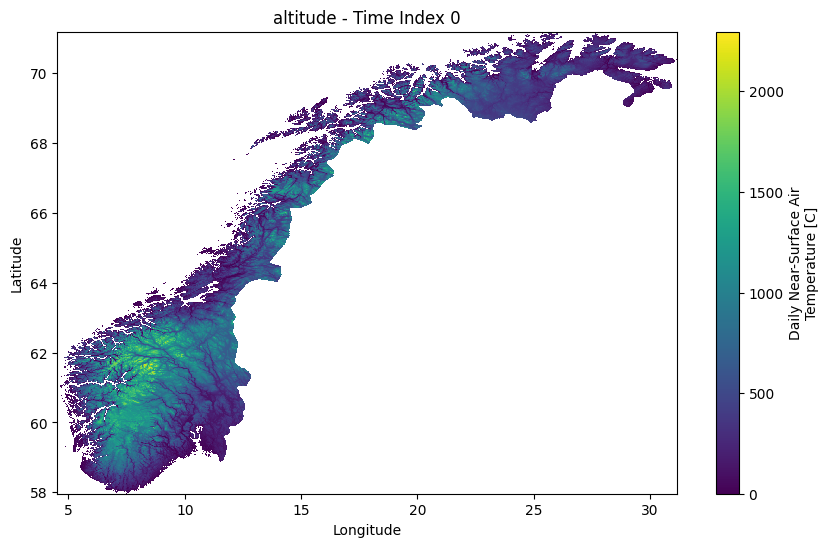

In [32]:
import matplotlib.pyplot as plt

# Extract one variable (e.g., 'gdd5') and select a time slice (e.g., first time point)
variable = "altitude"  # Change this to any variable in your dataset
time_index = 0  # Select a specific time index (0 for the first year, adjust as needed)

# Extract the data for the selected variable and time slice
data = norway_climate_cube.sel(variable=variable).isel(time=time_index)

# Plot the data (assuming the dimensions are latitude and longitude)
plt.figure(figsize=(10, 6))
data.plot()
plt.title(f"{variable} - Time Index {time_index}")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()
